In [5]:
import cv2
import numpy as np
import pylab
import matplotlib.pyplot as plt
from scipy import signal
from skimage.measure import compare_ssim as ssim
plt.rcParams['figure.figsize'] = 15, 8

## Question 1:
Perform Dense SIFT-based matching on the given pairs of images.

In this problem
1. I've computed the keypoints by taking keypoints at each window (window size specified by user or at least of size 8)
2. Each keypoint has radius of size to five times the size
3. Then I use the SIFT function of openCV to get descriptor for these points
4. After finding the descriptors, I've found the matches and drawn lines between these , matches

In [2]:
def ComputeDescriptors(img, step):
    kps = []
    startSize = 8 if step < 8 else step
    for i in range(step, img.shape[0]-step, step):
        for j in range(step, img.shape[1]-step, step):
            for z in range(startSize, startSize*5, startSize):
                kps.append(cv2.KeyPoint(float(i), float(j), float(z)))
    sift = cv2.xfeatures2d.SIFT_create()
    return sift.compute(img,kps)


In [18]:
def draw_matches(img1, img2,flag=False):
    if flag == True:
        sift = cv2.xfeatures2d.SIFT_create()
        kp1, des1 = sift.detectAndCompute(img1,None)
        kp2, des2 = sift.detectAndCompute(img2,None)
    else:
        kp1, des1 = ComputeDescriptors(img1,8)
        kp2, des2 = ComputeDescriptors(img2,8)
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des1,des2,k=2)
    #bf = cv2.BFMatcher()
    #matches = bf.knnMatch(des1[1],des2[1], k=2)
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append(m)
    #print(matches)
    good = sorted(good, key = lambda x:x.distance)
    #print(kp1)
    img3 = cv2.drawMatches(img1,kp1,img2,kp2,good[:], None,flags=2)
    #plt.imshow(img3)
    return img3

## Result

In [4]:
img1 = cv2.imread('Stereo_Images/Stereo_Pair1.jpg')

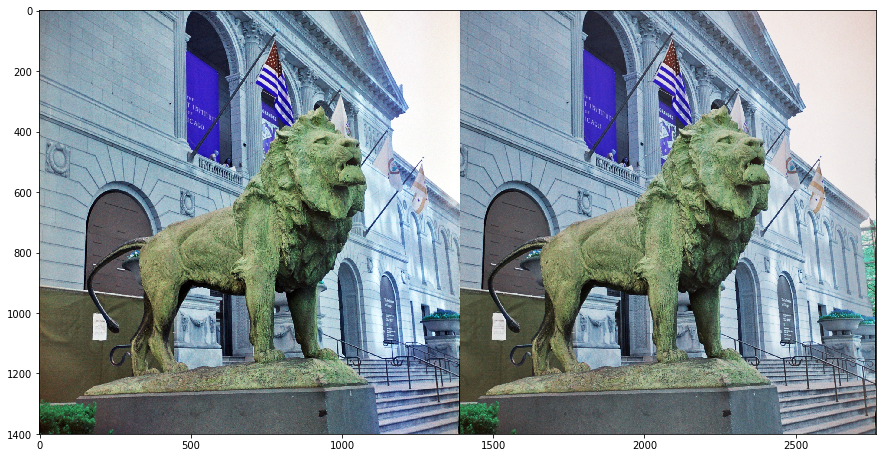

In [20]:
plt.imshow(img1)

In [6]:
h,w = (img1.shape[:2])
cropped_img11 = img1[0:h, 0:w//2]
cropped_img21 = img1[0:h, w//2:w]

In [7]:
matched_img1 = draw_matches(cropped_img11, cropped_img21)

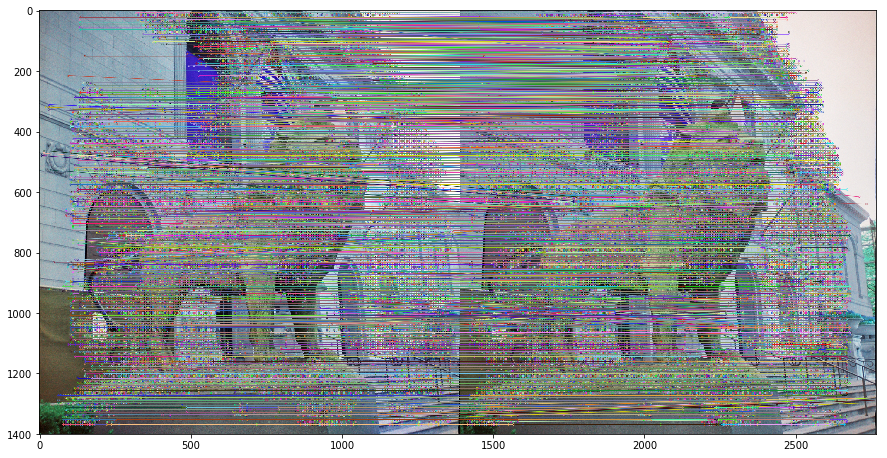

In [21]:
plt.imshow(matched_img1)

In [8]:
img2 = cv2.imread('Stereo_Images/Stereo_Pair2.jpg')

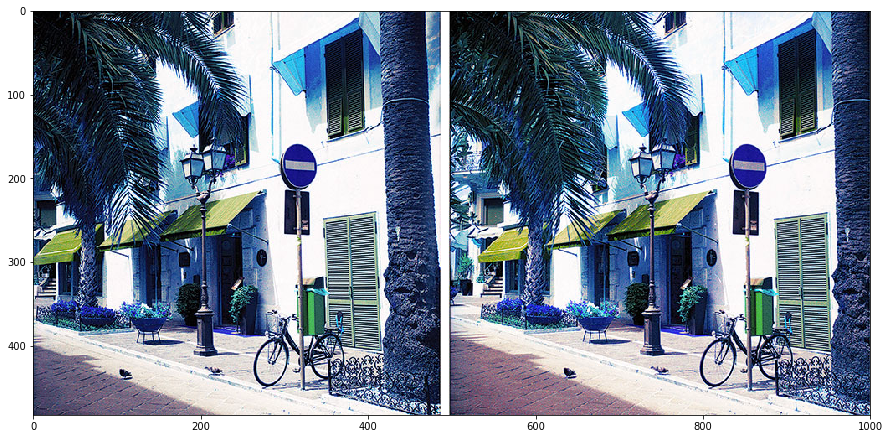

In [22]:
plt.imshow(img2)

In [9]:
h,w = (img2.shape[:2])
cropped_img12 = img2[0:h, 0:w//2]
cropped_img22 = img2[0:h, w//2:w]

In [12]:
matched_img2 = draw_matches(cropped_img12, cropped_img22)

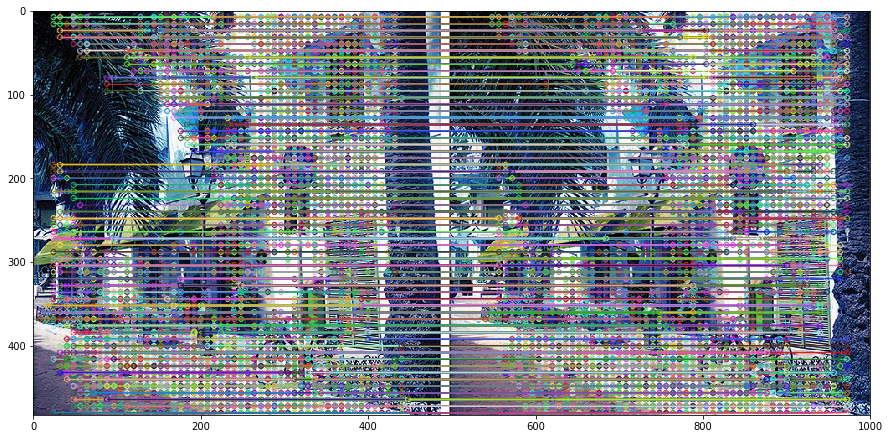

In [23]:
plt.imshow(matched_img2)

In [10]:
img3 = cv2.imread('Stereo_Images/Stereo_Pair3.jpg')

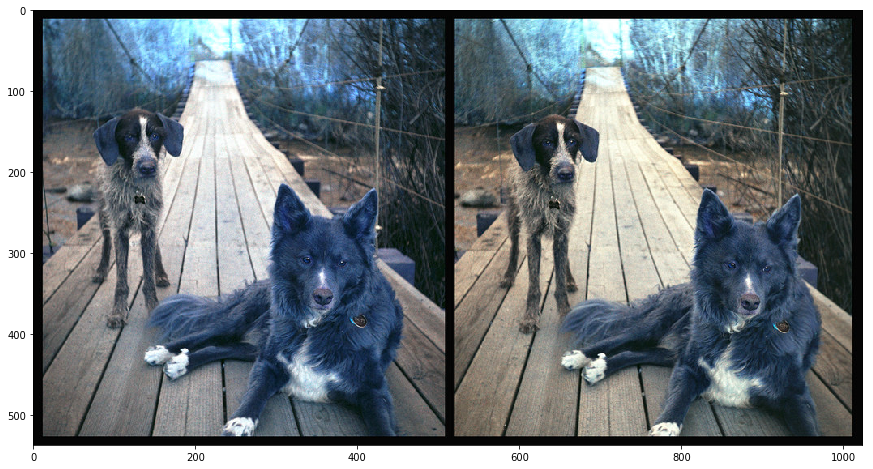

In [24]:
plt.imshow(img3)

In [11]:
h,w = (img3.shape[:2])
cropped_img13 = img3[0:h, 0:w//2]
cropped_img23 = img3[0:h, w//2:w]

In [17]:
matched_img3 = draw_matches(cropped_img13, cropped_img23)

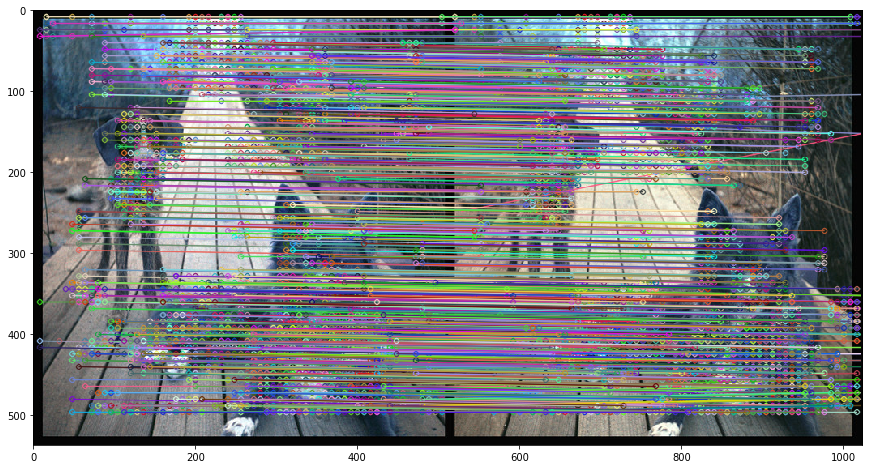

In [25]:
plt.imshow(matched_img3)

## Question 2
Perform Intensity Window-based correlation on the same set of images.

In this problem
1. I've taken a window of size mentioned by user
2. I've have matched this window with each window of the other image to get best intensity match
3. Intensity is matched using correlation coefficient
4. cv2.matchTemplate provides the topleft corner of matched window
5. After finding the matches I've drawn lines between the center of the match and current window

In [12]:
def intensity_based_matching(imgf1, imgf2, imgf3, window_size=64):
    img4 = imgf3.copy()
    window_size = window_size
    for i in range(0,imgf1.shape[0]-window_size, window_size):
        for j in range(0, imgf1.shape[1]-window_size, window_size):
            temp = imgf1[i:i+window_size, j:j+window_size]
            #print(temp)
            #plt.imshow(temp)
            res = cv2.matchTemplate(imgf2, temp, cv2.TM_CCORR_NORMED)
            #print(res)
            min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
            mid1 = (max_loc[0] + window_size//2+w//2, max_loc[1] + window_size//2)
            mid2 = (i + window_size//2, j + window_size//2)
            #print(mid1, mid2)
            cv2.circle(img4,mid1, 2, (0,0,255), -1)
            cv2.circle(img4,mid2, 2, (0,0,255), -1)
            cv2.line(img4, mid1, mid2, (0, 255, 0), thickness=1, lineType=8)
            #plt.imshow(img4)
            #cv2.drawMatches(cropped_img1,mid2,cropped_img2,mid1,None,img3,flags=2)
            #break
        #break
    return img4

## Result

In [50]:
i11 = cv2.cvtColor(cropped_img11, cv2.COLOR_BGR2GRAY)
i21 = cv2.cvtColor(cropped_img21, cv2.COLOR_BGR2GRAY)
res1 = intensity_based_matching(i11, i21, img1)

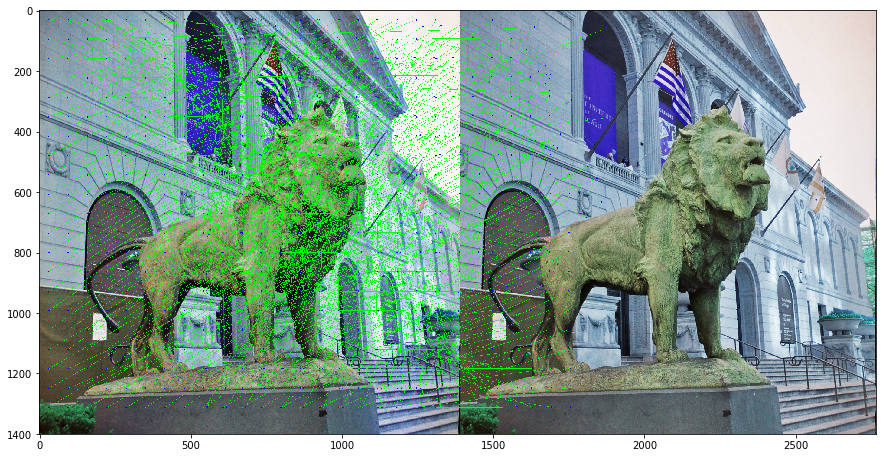

In [51]:
plt.imshow(res1)

In [35]:
i12 = cv2.cvtColor(cropped_img12, cv2.COLOR_BGR2GRAY)
i22 = cv2.cvtColor(cropped_img22, cv2.COLOR_BGR2GRAY)
res2 = intensity_based_matching(i12, i22, img2)

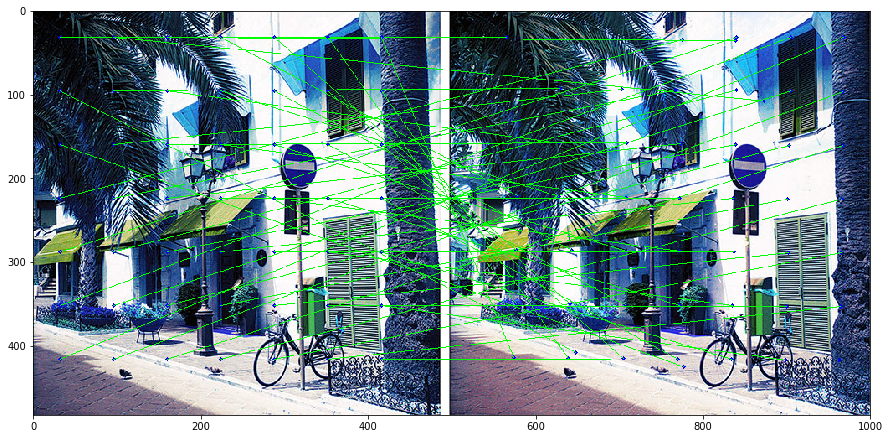

In [36]:
plt.imshow(res2)

In [37]:
i13 = cv2.cvtColor(cropped_img13, cv2.COLOR_BGR2GRAY)
i23 = cv2.cvtColor(cropped_img23, cv2.COLOR_BGR2GRAY)
res3 = intensity_based_matching(i11, i21, img3)

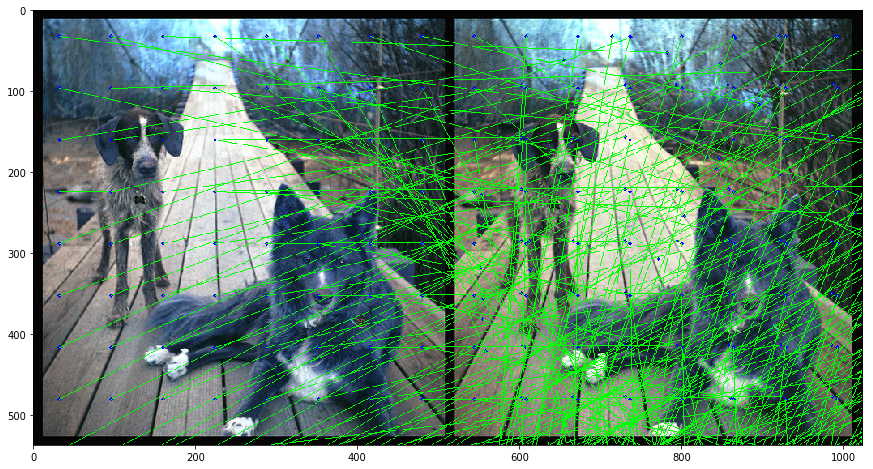

In [38]:
plt.imshow(res3)

## Question 3
Give a comparison of the two methods

- By Intensity matching, even there can be matches where the regions may be different but they have the intensity
- In dense SIFT based matching, we get matches where matches are better and so this method is better than intnsity based method

#### Comparison on images

Dense SIFT based matched Image


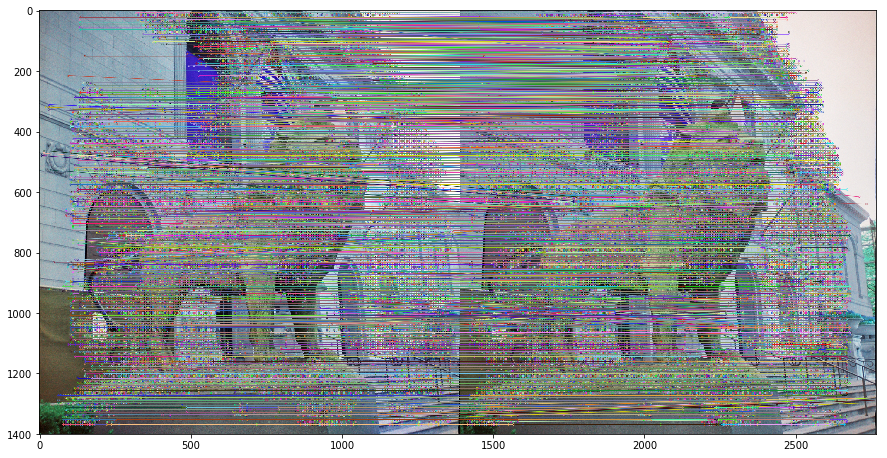

In [53]:
print("Dense SIFT based matched Image")
plt.imshow(matched_img1)

Intensity based matched image


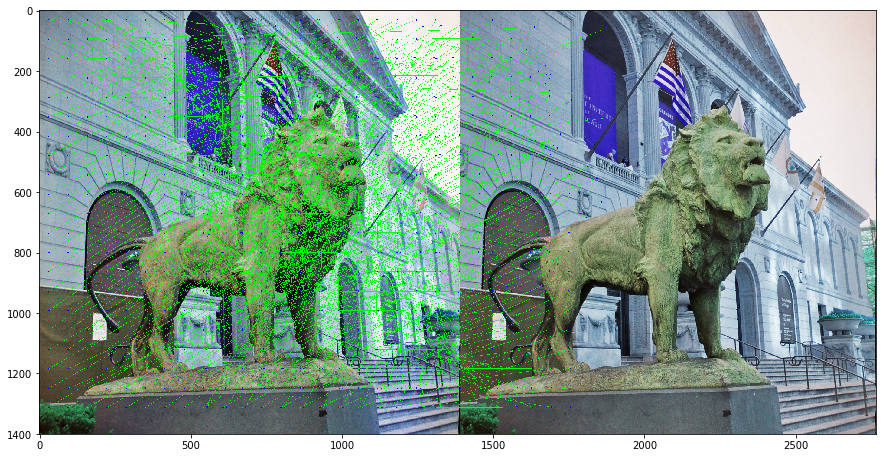

In [54]:
print("Intensity based matched image")
plt.imshow(res1)

Dense SIFT based matched Image


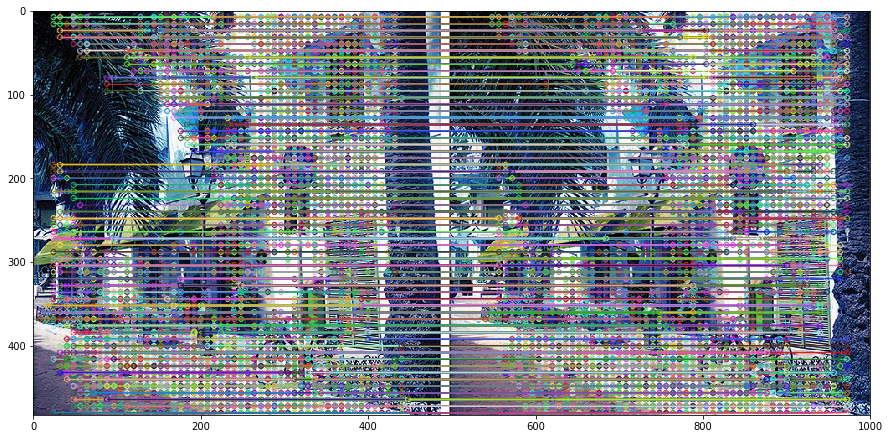

In [55]:
print("Dense SIFT based matched Image")
plt.imshow(matched_img2)

Intensity based matched image


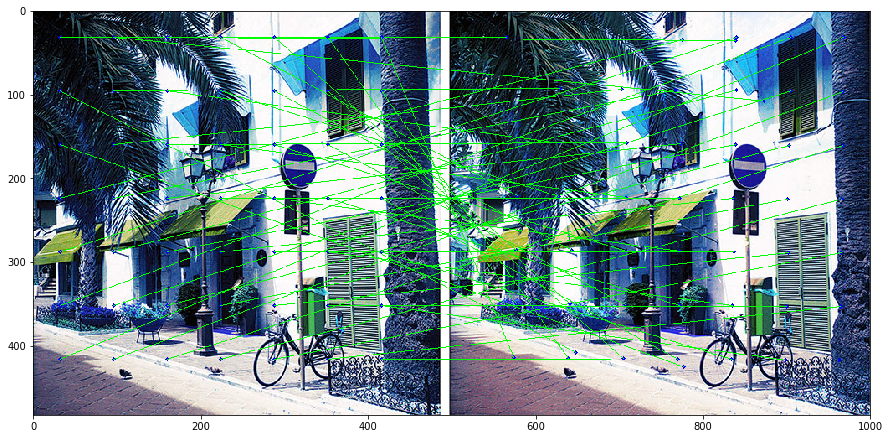

In [57]:
print("Intensity based matched image")
plt.imshow(res2)

Dense SIFT based matched Image


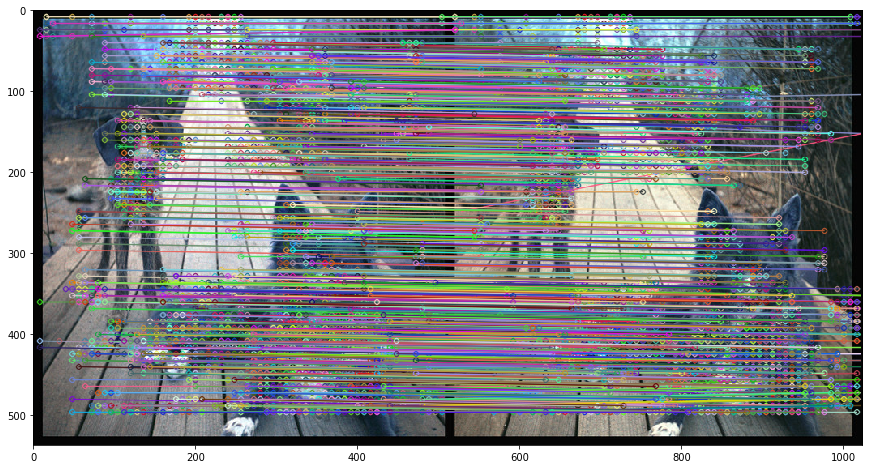

In [60]:
print("Dense SIFT based matched Image")
plt.imshow(matched_img3)

Intensity based matched image


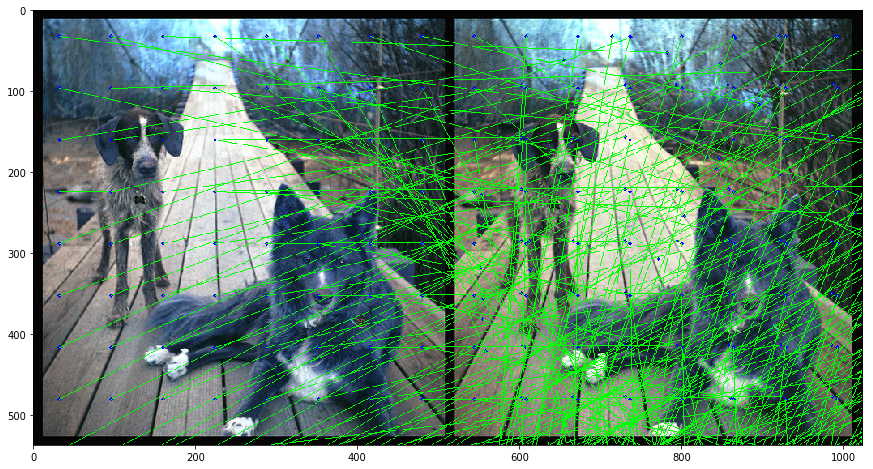

In [61]:
print("Intensity based matched image")
plt.imshow(res3)

## Question 4
Rectify the pairs of images and with these new images, repeat steps 1 to 3.

To rectify images
1. I've computed the keypoints and descriptor using SIFT
2. Then found the good matches
3. Using these good matches I've found the fFundamental matrix for the points of these image
4. Then used the *cv2.stereoRectifyUncalibrated* method to get the rectified matrix
5. I've then computed the rectified image using the cv2.warpPerspective function

In [13]:
def rectify_images(img1,img2):
    sift = cv2.xfeatures2d.SIFT_create()

    # find the keypoints and descriptors with SIFT
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    flann = cv2.FlannBasedMatcher(index_params, search_params)

    matches = flann.knnMatch(des1,des2,k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    pts1 = []
    pts2 = []
    for m,n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)
            pts2.append(kp2[m.trainIdx].pt)
            pts1.append(kp1[m.queryIdx].pt)
    pts1 = np.array(pts1)
    pts2 = np.array(pts2)
    F,mask= cv2.findFundamentalMat(pts1,pts2,cv2.FM_LMEDS)
    pts1 = pts1[:,:][mask.ravel()==1]
    pts2 = pts2[:,:][mask.ravel()==1]

    pts1 = np.int32(pts1)
    pts2 = np.int32(pts2)

    p1fNew = pts1.reshape((pts1.shape[0] * 2, 1))
    p2fNew = pts2.reshape((pts2.shape[0] * 2, 1))

    retBool ,rectmat1, rectmat2 = cv2.stereoRectifyUncalibrated(p1fNew,p2fNew,F,img1.shape[:2])

    dst11 = cv2.warpPerspective(img1,rectmat1, img1.shape[:2])
    dst22 = cv2.warpPerspective(img2,rectmat2, img2.shape[:2])
    #plt.imshow(dst22)
    return dst11, dst22

## Result

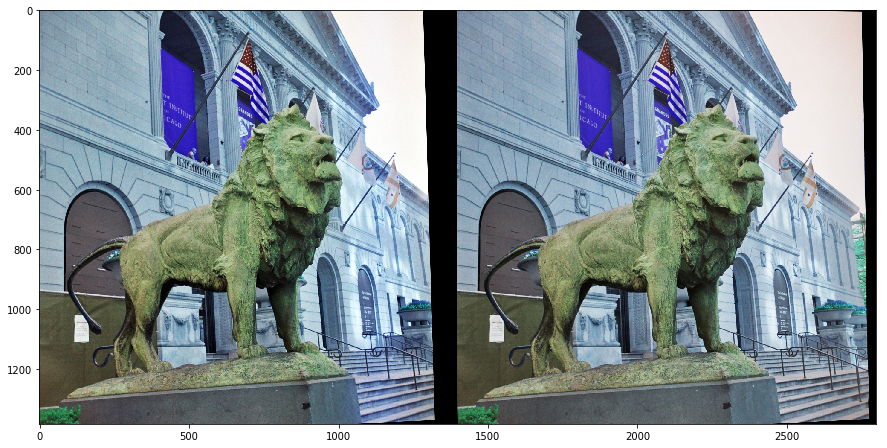

In [14]:
i31,i41 = rectify_images(cropped_img11,cropped_img21)
i51 = draw_matches(i31,i41, flag=True)
plt.imshow(i51)

#### DenseSIFT on rectified image

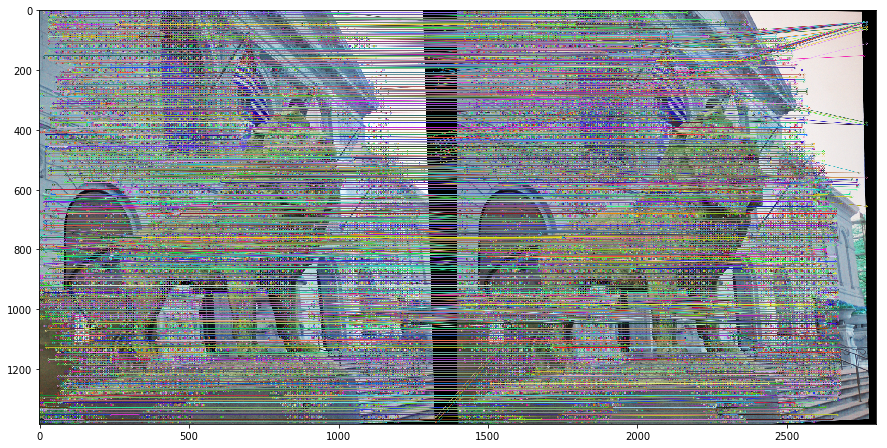

In [19]:
matched_imgr1 = draw_matches(i31, i41)
plt.imshow(matched_imgr1)

#### Intensity matching on rectified image

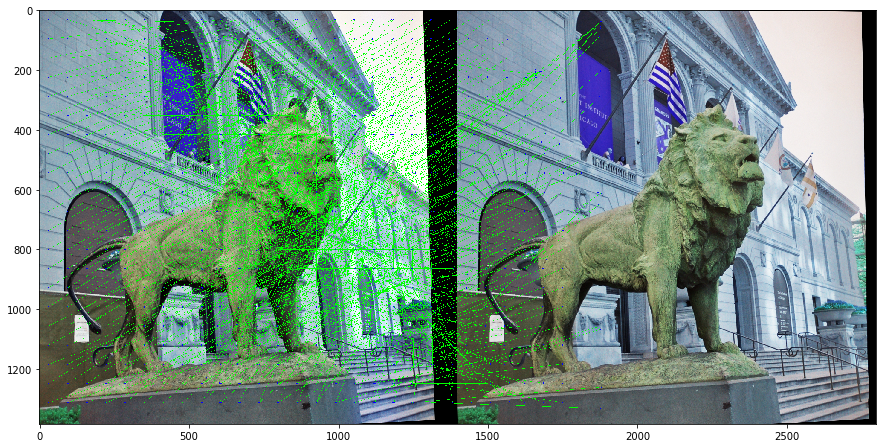

In [15]:
i11r = cv2.cvtColor(i31, cv2.COLOR_BGR2GRAY)
i21r = cv2.cvtColor(i41, cv2.COLOR_BGR2GRAY)
res1r = intensity_based_matching(i11r, i21r, i51)
plt.imshow(res1r)

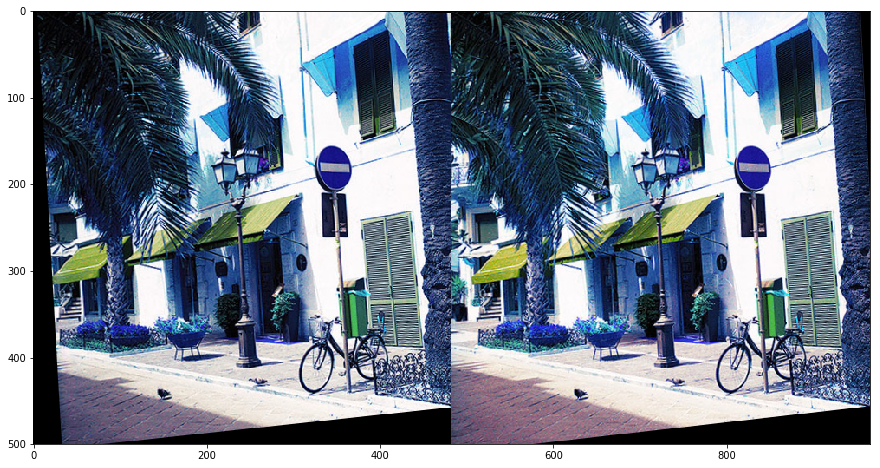

In [16]:
i32,i42 = rectify_images(cropped_img12,cropped_img22)
i52 = draw_matches(i32,i42, flag=True)
plt.imshow(i52)

#### DenseSIFT on rectified image

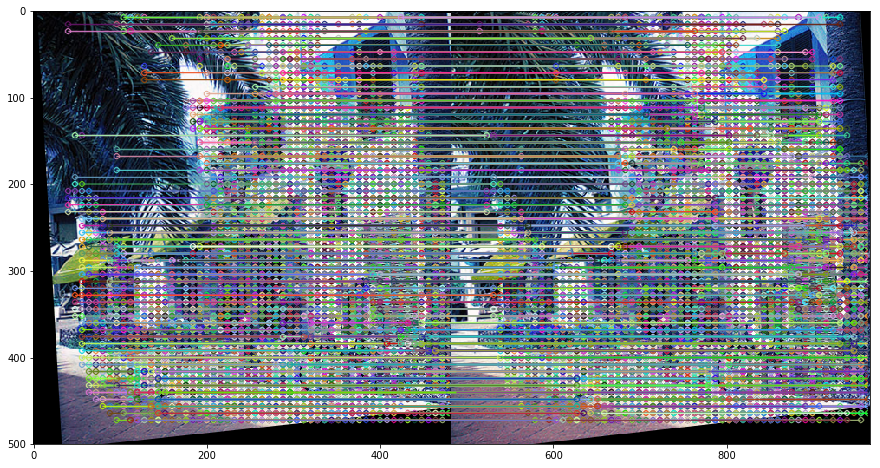

In [20]:
matched_imgr2 = draw_matches(i32, i42)
plt.imshow(matched_imgr2)

#### Intensity matching on rectified image

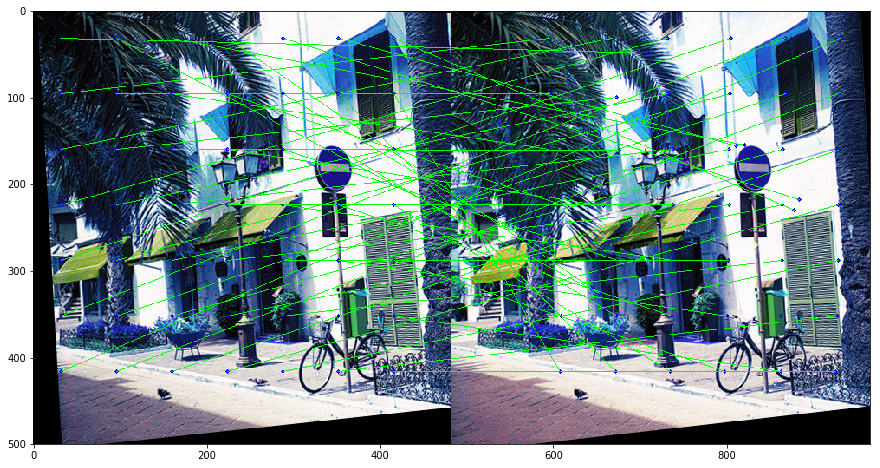

In [21]:
i12r = cv2.cvtColor(i32, cv2.COLOR_BGR2GRAY)
i22r = cv2.cvtColor(i42, cv2.COLOR_BGR2GRAY)
res2r = intensity_based_matching(i12r, i22r, i52)
plt.imshow(res2r)

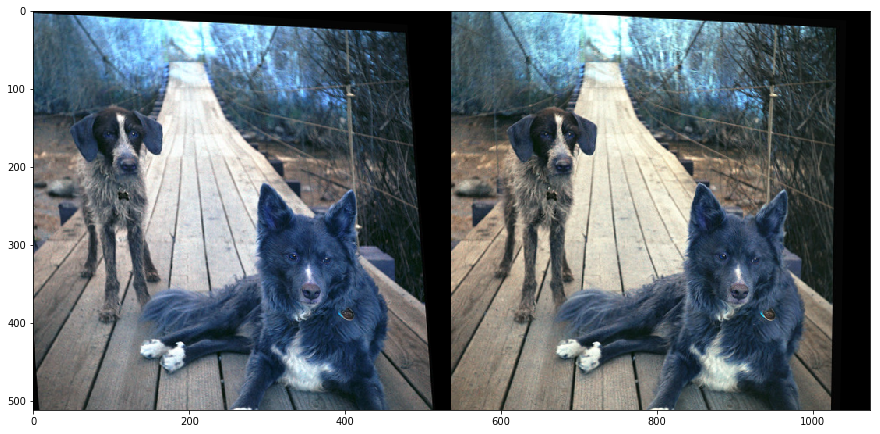

In [17]:
i33,i43 = rectify_images(cropped_img13,cropped_img23)
i53 = draw_matches(i33,i43, flag=True)
plt.imshow(i53)

#### DenseSIFT on rectified image

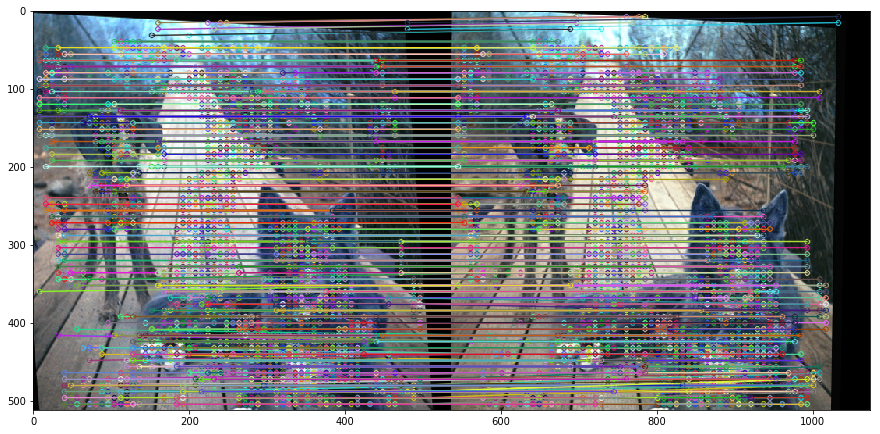

In [22]:
matched_imgr3 = draw_matches(i33, i43)
plt.imshow(matched_imgr3)

#### Intensity matching on rectified image

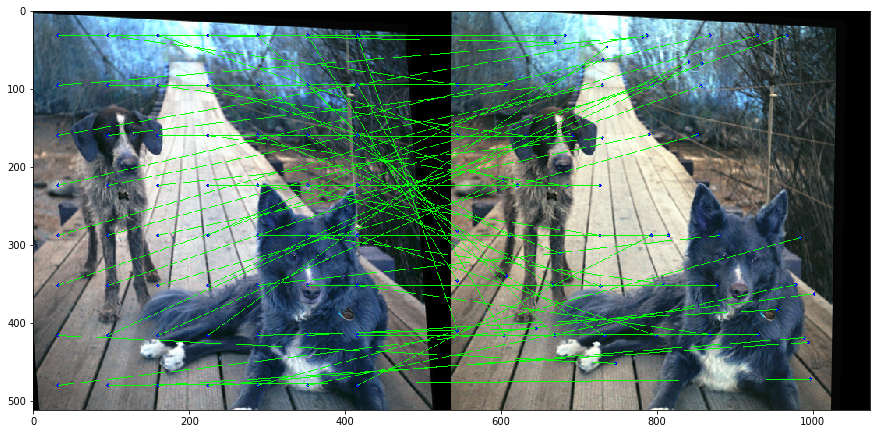

In [23]:
i13r = cv2.cvtColor(i33, cv2.COLOR_BGR2GRAY)
i23r = cv2.cvtColor(i43, cv2.COLOR_BGR2GRAY)
res3r = intensity_based_matching(i13r, i23r, i53)
plt.imshow(res3r)

## Question 5
Compare with Greedy Matching and DTW on the rectified images

In greedy matching:
1. I've matched the current window of first image, with each window of second image in the same line
2. Drawn lines between the windows with best match
3. Best match is computed using correlation_coefficient of the windows

In [24]:
def greedy_matching(img1, img2, img3):
    window_size = 128
    img4 = img3.copy()
    for i in range(0, img1.shape[1]-window_size, window_size):
        for j in range(0, img1.shape[0]-window_size, window_size):
            tmp1 = img1[i:i+window_size, j:j+window_size]
            cor = -1e19
            mt = 0
            for k in range(0, img2.shape[0]-window_size, window_size):
                tmp2 = img2[i:i+window_size, k:k+window_size]
                cort = correlation_coefficient (tmp1, tmp2)
                #cv2.rectangle(img2,(k,i), (k+window_size,i+window_size), 255, 20)
                #print(cort)
                #plt.imshow(img2)
                if cort>cor:
                    #print(k)
                    cor=cort
                    mt = k
            mid1 = (j + window_size//2, i + window_size//2)
            mid2 = (mt + window_size//2+w//2, i + window_size//2)
            #print(mid1, mid2)
            cv2.circle(img4,mid1, 5, (0,0,255), -1)
            cv2.circle(img4,mid2, 5, (0,0,255), -1)
            cv2.line(img4, mid1, mid2, (0, 255, 0), thickness=2, lineType=8)
            #plt.imshow(img4)
    return img4

In [25]:
def correlation_coefficient(patch1, patch2):
    product = np.mean((patch1 - patch1.mean()) * (patch2 - patch2.mean()))
    stds = patch1.std() * patch2.std()
    if stds == 0:
        return 0
    else:
        product /= stds
        return product

## Result

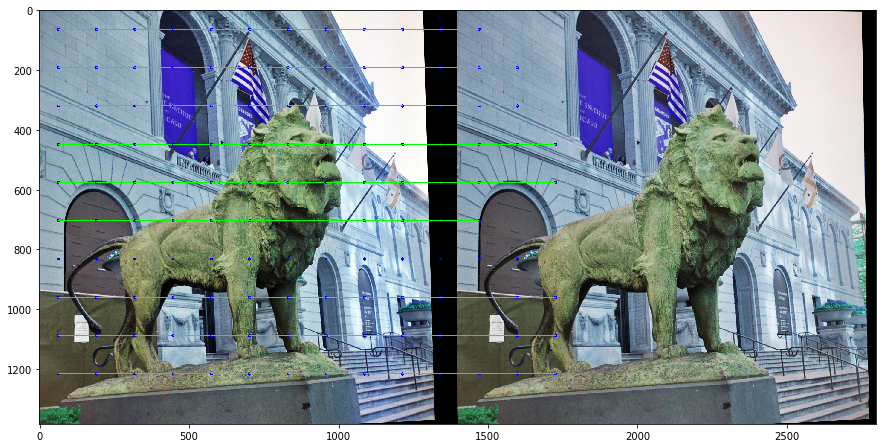

In [26]:
i61 = greedy_matching(cv2.cvtColor(i31, cv2.COLOR_BGR2GRAY), cv2.cvtColor(i41, cv2.COLOR_BGR2GRAY), i51)
plt.imshow(i61)

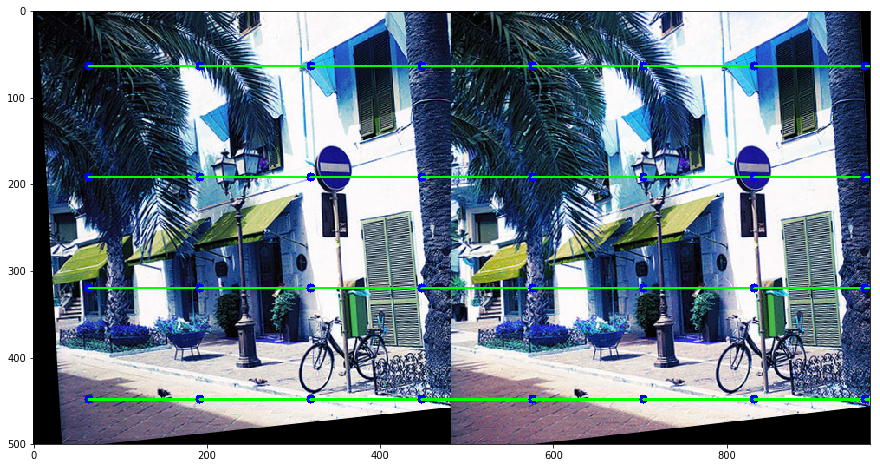

In [27]:
i62 = greedy_matching(cv2.cvtColor(i31, cv2.COLOR_BGR2GRAY), cv2.cvtColor(i41, cv2.COLOR_BGR2GRAY), i52)
plt.imshow(i62)

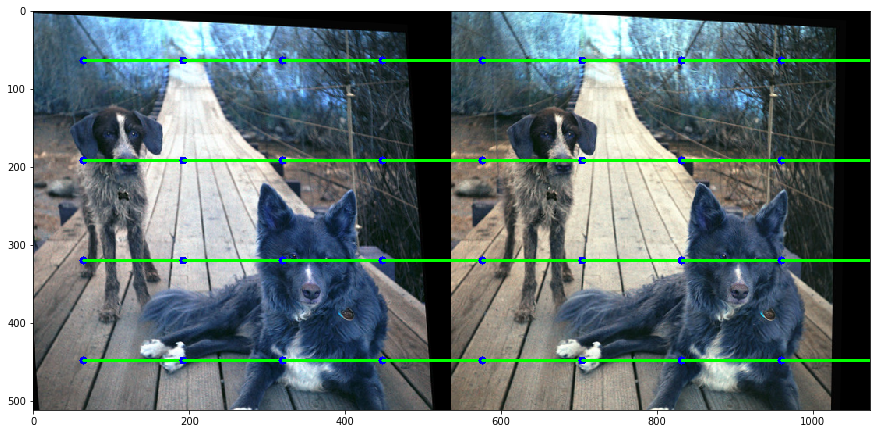

In [28]:
i63 = greedy_matching(cv2.cvtColor(i31, cv2.COLOR_BGR2GRAY), cv2.cvtColor(i41, cv2.COLOR_BGR2GRAY), i53)
plt.imshow(i63)

In DTW method:
1. I've taken a distance matrix, that gives the correlation_coefficient of each window in the same line
2. Then I've computed the minimum cost between windows in the same line
3. Then I've computed the windows that has best matches by traversing the accumulated_cost grid
4. Then I've drawn lines between the matches

In [29]:
def distance_cost_plot(distances):
    im = plt.imshow(distances, interpolation='nearest', cmap='Reds') 
    plt.gca().invert_yaxis()
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.grid()
    plt.colorbar();

def dtw_matching(img1, img2, img3):
    window_size = 128
    img4 = img3.copy()
    for i in range(0, img1.shape[1]-window_size, window_size):
        distances = np.zeros((img1.shape[0]//window_size, img2.shape[0]//window_size))
        for k1 in range(img1.shape[0]//window_size):
            for k2 in range(img2.shape[0]//window_size):
                tmp1 = img1[i:i+window_size, k1*window_size:k1*window_size+window_size]
                tmp2 = img2[i:i+window_size, k2*window_size:k2*window_size+window_size]
                distances[k1,k2] = correlation_coefficient(tmp1, tmp2)
        #distance_cost_plot(distances)
        accumulated_cost = np.zeros((img1.shape[0]//window_size, img2.shape[0]//window_size))
        accumulated_cost[0,0] = distances[0,0]
        for k1 in range(1,img2.shape[0]//window_size):
            accumulated_cost[0,k1] = distances[0,k1] + accumulated_cost[0, k1-1]   
        #distance_cost_plot(accumulated_cost)
        for k1 in range(1, img1.shape[0]//window_size):
            accumulated_cost[k1,0] = distances[k1, 0] + accumulated_cost[k1-1, 0] 
        #distance_cost_plot(accumulated_cost)
        for k1 in range(1, img1.shape[0]//window_size):
            for k2 in range(1, img2.shape[0]//window_size):
                accumulated_cost[k1, k2] = min(accumulated_cost[k1-1, k2-1], 
                                               accumulated_cost[k1-1, k2], accumulated_cost[k1, k2-1]) + distances[k1, k2]
        #distance_cost_plot(accumulated_cost)
        path = [[img2.shape[0]//window_size-1, img1.shape[0]//window_size-1]]
        k1 = img1.shape[0]//window_size-1
        k2 = img2.shape[0]//window_size-1
        while k1>0 and k2>0:
            if k1==0:
                k2 = k2 - 1
            elif k2==0:
                k1 = k1 - 1
            else:
                if accumulated_cost[k1-1, k2] == min(accumulated_cost[k1-1, k2-1], accumulated_cost[k1-1, k2], accumulated_cost[k1, k2-1]):
                    k1 = k1 - 1
                elif accumulated_cost[k1, k2-1] == min(accumulated_cost[k1-1, k2-1], accumulated_cost[k1-1, k2], accumulated_cost[k1, k2-1]):
                    k2 = k2-1
                else:
                    k1 = k1 - 1
                    k2= k2- 1
            path.append([k2, k1])
        path.append([0,0])
        for k in path:
            mid1 = (k[0]*window_size + window_size//2, i + window_size//2)
            mid2 = (k[1]*window_size + window_size//2+w//2, i + window_size//2)
            #print(mid1, mid2)
            cv2.circle(img4,mid1, 5, (0,0,255), -1)
            cv2.circle(img4,mid2, 5, (0,0,255), -1)
            cv2.line(img4, mid1, mid2, (0, 255, 0), thickness=2, lineType=8)
        #plt.imshow(img4)
        #break
    return img4
#         for j in range(0, img1.shape[0]-window_size, window_size):
#             for k in range(0, img2.shape[0]-window_size, window_size):
#                 tmp1 = img1[i:i+window_size, j:j+window_size]
#                 tmp2 = img2[i:i+window_size, k:k+window_size]
#                 cort = correlation_coefficient (tmp1, tmp2)
#                 #cv2.rectangle(img2,(k,i), (k+window_size,i+window_size), 255, 20)
#                 #print(cort)
#                 #plt.imshow(img2)
#                 if cort>cor:
#                     #print(k)
#                     cor=cort
#                     mt = k
#             mid1 = (j + window_size//2, i + window_size//2)
#             mid2 = (mt + window_size//2+w//2, i + window_size//2)
#             #print(mid1, mid2)
#             cv2.circle(img4,mid1, 5, (0,0,255), -1)
#             cv2.circle(img4,mid2, 5, (0,0,255), -1)
#             cv2.line(img4, mid1, mid2, (0, 255, 0), thickness=2, lineType=8)
#             #plt.imshow(img4)
#     return img4

## Result

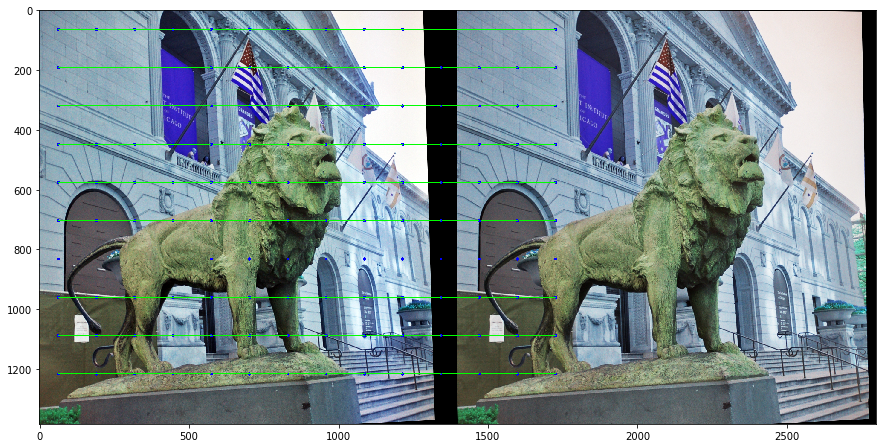

In [30]:
i71 = dtw_matching(i31, i41, i51)
plt.imshow(i71)

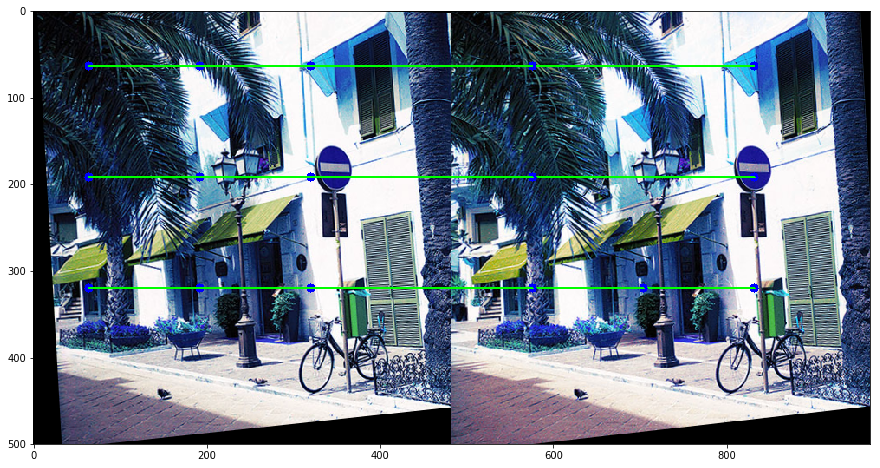

In [31]:
i72 = dtw_matching(i32, i42, i52)
plt.imshow(i72)

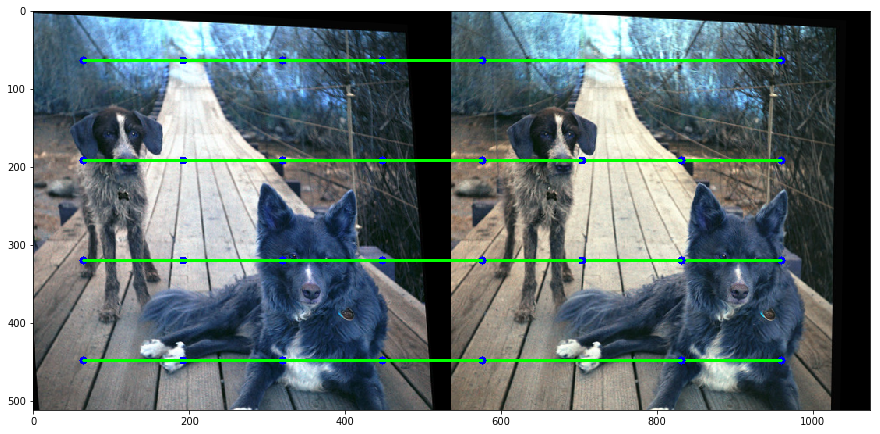

In [32]:
i73 = dtw_matching(i33, i43, i53)
plt.imshow(i73)